# Cluster Analysis

## Extract Potential Threshold Values to Discriminate between Fall and ADL

Each trial of stimulated activity is presented as a time series of sensor data collected over a 10, 30, or 60 second interval. As a prelimary method to process this data, the maximum value from every trial will be taken as a potential threshold to represent that particular activity. By clustering on these values, we hope to identify potential threshold acceleration and angular velocity values that discriminates a fall from an ADL.

In future analyses, different processing methods should be attempted to preserve more data from the experimental trials as this approach discards all of the sensor measurements besides the max value.

In [1]:
import datetime
import pandas as pd
import numpy as np
from statistics import mean
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from sklearn.metrics import accuracy_score

In [2]:
# Load Data
rawData = pd.read_csv('https://raw.githubusercontent.com/mjwolfe91/MSDS_Capstone_JC_AN_MW/master/Data/HAR_FALL-UP_CompleteDataSet.csv')

# Extract Wrist Sensor Data (Angular/Accelerometer) from each trial for every subject
# 17 subjects * 11 activities (ADL/Falls) * 3 trials = 561 trials
# Sensors set at sampling rate of ~18.4 Hz (18-20 Hz)
raw_WristSensor = rawData[['TimeStamps','WristAccelerometer', 'Unnamed: 30', 'Unnamed: 31', 'WristAngularVelocity', 'Unnamed: 33', 'Unnamed: 34','Subject', 'Activity', 'Trial']]
# Rename Columns
raw_WristSensor.rename(columns = {'TimeStamps':'TimeStamp', 'WristAccelerometer': 'Accelerometer (x)', 'Unnamed: 30':'Accelerometer (y)','Unnamed: 31':'Accelerometer (z)', 'WristAngularVelocity': 'Angular Velocity (x)', 'Unnamed: 33':'Angular Velocity (y)','Unnamed: 34':'Angular Velocity (z)'}, inplace = True)
# Change data types 
raw_WristSensor.TimeStamp = pd.to_datetime(raw_WristSensor.TimeStamp)
for col in ['Accelerometer (x)','Accelerometer (y)','Accelerometer (z)','Angular Velocity (x)','Angular Velocity (y)','Angular Velocity (z)']:
    raw_WristSensor[col] = pd.to_numeric(raw_WristSensor[1:][col])
#for col in ['Subject', 'Activity', 'Trial']:
#    raw_WristSensor[col] = raw_WristSensor[col].astype('category')
#raw_WristSensor.dtypes

# Magntiude of Accelerometer and Gyroscope sensors
a_mag = np.sqrt(raw_WristSensor['Accelerometer (x)']**2 + raw_WristSensor['Accelerometer (y)']**2 + raw_WristSensor['Accelerometer (z)']**2)
w_mag = np.sqrt(raw_WristSensor['Angular Velocity (x)']**2 + raw_WristSensor['Angular Velocity (y)']**2 + raw_WristSensor['Angular Velocity (z)']**2)
raw_WristSensor.insert(10, 'Acceleration Magntiude', a_mag)
raw_WristSensor.insert(11, 'Angular Velocity Magntiude', w_mag)

In [3]:
raw_WristSensor.dtypes

TimeStamp                     datetime64[ns]
Accelerometer (x)                    float64
Accelerometer (y)                    float64
Accelerometer (z)                    float64
Angular Velocity (x)                 float64
Angular Velocity (y)                 float64
Angular Velocity (z)                 float64
Subject                              float64
Activity                             float64
Trial                                float64
Acceleration Magntiude               float64
Angular Velocity Magntiude           float64
dtype: object

In [4]:
def sortTrial(dict_,row_):
    if raw_WristSensor.Trial[i] == 1:
        dict_['T1'].append(row_)
    elif raw_WristSensor.Trial[i] == 2:
        dict_['T2'].append(row_)
    elif raw_WristSensor.Trial[i] == 3:
        dict_['T3'].append(row_)

def sortActivityTrial(dict_,row_):
    if raw_WristSensor.Activity[i] == 1:
        sortTrial(dict_['A1'],row_)
        #dict_['A1'].append(row_)
    elif raw_WristSensor.Activity[i] == 2:
        sortTrial(dict_['A2'],row_)
        #dict_['A2'].append(row_)
    elif raw_WristSensor.Activity[i] == 3:
        sortTrial(dict_['A3'],row_)
        #dict_['A3'].append(row_)
    elif raw_WristSensor.Activity[i] == 4:
        sortTrial(dict_['A4'],row_)
        #dict_['A4'].append(row_)
    elif raw_WristSensor.Activity[i] == 5:
        sortTrial(dict_['A5'],row_)
        #dict_['A5'].append(row_)
    elif raw_WristSensor.Activity[i] == 6:
        sortTrial(dict_['A6'],row_)
        #dict_['A6'].append(row_)
    elif raw_WristSensor.Activity[i] == 7:
        sortTrial(dict_['A7'],row_)
        #dict_['A7'].append(row_)
    elif raw_WristSensor.Activity[i] == 8:
        sortTrial(dict_['A8'],row_)
        #dict_['A8'].append(row_)
    elif raw_WristSensor.Activity[i] == 9:
        sortTrial(dict_['A9'],row_)
        #dict_['A9'].append(row_)
    elif raw_WristSensor.Activity[i] == 10:
        sortTrial(dict_['A10'],row_)
        #dict_['A10'].append(row_)
    elif raw_WristSensor.Activity[i] == 11:
        sortTrial(dict_['A11'],row_)
        #dict_['A11'].append(row_)

In [5]:
# Aggregate Wrist Sensor data by Subjects, Activity, and Trial
WristS_Subjects = {}

for s in np.unique(raw_WristSensor.Subject[1:]):
    WristS_Subjects["S{0}".format(int(s))] = {"A1":{"T1":[],"T2":[],"T3":[]},"A2":{"T1":[],"T2":[],"T3":[]},"A3":{"T1":[],"T2":[],"T3":[]},"A4":{"T1":[],"T2":[],"T3":[]},"A5":{"T1":[],"T2":[],"T3":[]}, "A6":{"T1":[],"T2":[],"T3":[]},
                                              "A7":{"T1":[],"T2":[],"T3":[]},"A8":{"T1":[],"T2":[],"T3":[]},"A9":{"T1":[],"T2":[],"T3":[]},"A10":{"T1":[],"T2":[],"T3":[]},"A11":{"T1":[],"T2":[],"T3":[]}}


for i, row in raw_WristSensor[1:].iterrows():
    if raw_WristSensor.Subject[i] == 1:
        sortActivityTrial(WristS_Subjects['S1'],row)
    elif raw_WristSensor.Subject[i] == 2:
        sortActivityTrial(WristS_Subjects['S2'],row)
    elif raw_WristSensor.Subject[i] == 3:
        sortActivityTrial(WristS_Subjects['S3'],row)
    elif raw_WristSensor.Subject[i] == 4:
        sortActivityTrial(WristS_Subjects['S4'],row)
    elif raw_WristSensor.Subject[i] == 5:
        sortActivityTrial(WristS_Subjects['S5'],row)
    elif raw_WristSensor.Subject[i] == 6:
        sortActivityTrial(WristS_Subjects['S6'],row)
    elif raw_WristSensor.Subject[i] == 7:
        sortActivityTrial(WristS_Subjects['S7'],row)
    elif raw_WristSensor.Subject[i] == 8:
        sortActivityTrial(WristS_Subjects['S8'],row)
    elif raw_WristSensor.Subject[i] == 9:
        sortActivityTrial(WristS_Subjects['S9'],row)
    elif raw_WristSensor.Subject[i] == 10:
        sortActivityTrial(WristS_Subjects['S10'],row)
    elif raw_WristSensor.Subject[i] == 11:
        sortActivityTrial(WristS_Subjects['S11'],row)
    elif raw_WristSensor.Subject[i] == 12:
        sortActivityTrial(WristS_Subjects['S12'],row)
    elif raw_WristSensor.Subject[i] == 13:
        sortActivityTrial(WristS_Subjects['S13'],row)
    elif raw_WristSensor.Subject[i] == 14:
        sortActivityTrial(WristS_Subjects['S14'],row)
    elif raw_WristSensor.Subject[i] == 15:
        sortActivityTrial(WristS_Subjects['S15'],row)
    elif raw_WristSensor.Subject[i] == 16:
        sortActivityTrial(WristS_Subjects['S16'],row)
    elif raw_WristSensor.Subject[i] == 17:
        sortActivityTrial(WristS_Subjects['S17'],row)

# Change lists to numpy array
# Column idx of numpy array [0:Timestamp, 1: Accelerometer (x), 2: Accelerometer (y), 3: Accelerometer (z),
#                                         4: Angular Velocity (x), 5 Angular Velocity (y), 6: Angular Velocity (z)
#                                         7: Subject, 8: Activity, 9: Trial, 10: Acceleration Magntiude, 11: Angular Velcoity Magntiude]
for subject in WristS_Subjects.keys():
    for activity in WristS_Subjects[subject].keys():
        for trial in WristS_Subjects[subject][activity].keys():
            WristS_Subjects[subject][activity][trial] = np.array(WristS_Subjects[subject][activity][trial])
            WristS_Subjects[subject][activity][trial] = np.reshape(WristS_Subjects[subject][activity][trial], (-1,12))

In [6]:
cluster_thresholds = pd.DataFrame(columns = ["Subject","Activity","Trial","Max Acceleration Magnitude","Max Angular Velocity Magnitude"])
# Column idx of dataframe [0:Subject, 1: Activity, 2: Trial, 3: Max Acceleration Magnitude, 4: Max Angular Velocity Magnitude]

for subject in WristS_Subjects.keys():
    for activity in WristS_Subjects[subject].keys():
        for trial in WristS_Subjects[subject][activity].keys():
            # Subject 8 is missing data for Trials 2/3 of Activity 11
            if (subject == "S8") & (activity == "A11") & (trial in ["T2","T3"]):
                continue
            else:
                maxA = max(WristS_Subjects[subject][activity][trial][:,10])
                maxW = max(WristS_Subjects[subject][activity][trial][:,11])
                s = mean(WristS_Subjects[subject][activity][trial][:,7])
                a = mean(WristS_Subjects[subject][activity][trial][:,8])
                t = mean(WristS_Subjects[subject][activity][trial][:,9])
                cluster_thresholds = cluster_thresholds.append({"Subject":s, "Activity":a, "Trial":t, "Max Acceleration Magnitude":maxA, "Max Angular Velocity Magnitude":maxW}, ignore_index=True)

In [7]:
cluster_thresholds

,Subject,Activity,Trial,Max Acceleration Magnitude,Max Angular Velocity Magnitude
0,1.0,1.0,1.0,4.998200,557.309722
1,1.0,1.0,2.0,4.483198,334.218375
2,1.0,1.0,3.0,3.323694,363.059450
3,1.0,2.0,1.0,2.722826,721.363913
4,1.0,2.0,2.0,3.129536,558.034051
...,...,...,...,...,...
554,17.0,10.0,2.0,4.084658,974.366832
555,17.0,10.0,3.0,4.221304,579.381561
556,17.0,11.0,1.0,1.886194,487.409934
557,17.0,11.0,2.0,1.071376,3.942320


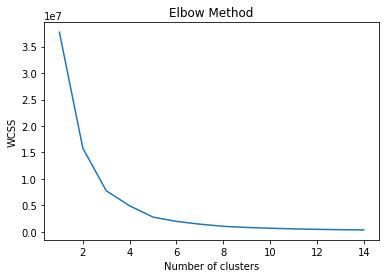

In [8]:
ct = cluster_thresholds
wcss = []
for i in range(1, 15):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(ct)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 15), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

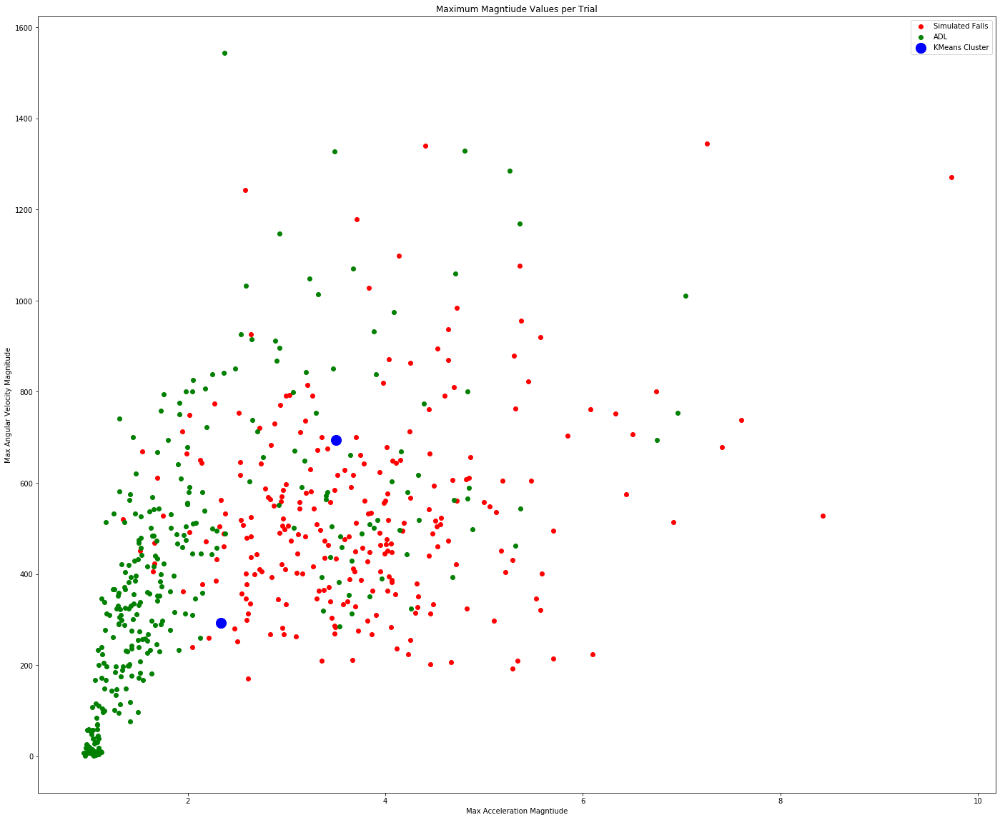

In [9]:
kmeans_MaxMagnitude = KMeans(n_clusters=2, init='k-means++', max_iter=300, n_init=10, random_state=0)
clusters_MaxMagnitude = kmeans_MaxMagnitude.fit_predict(cluster_thresholds)
fig=plt.figure(figsize = (24,20))
plt.scatter(x=ct.iloc[:,3][ct['Activity']<6], y=ct.iloc[:,4][ct['Activity']<6], c="red", label='Simulated Falls')
plt.scatter(x=ct.iloc[:,3][ct['Activity']>5], y=ct.iloc[:,4][ct['Activity']>5], c="green", label="ADL")
plt.scatter(kmeans_MaxMagnitude.cluster_centers_[:, 3], kmeans_MaxMagnitude.cluster_centers_[:, 4], s=200, c='blue', label="KMeans Cluster")
plt.title("Maximum Magntiude Values per Trial")
plt.ylabel("Max Angular Velocity Magnitude")
plt.xlabel("Max Acceleration Magntiude")
plt.legend()
plt.show()

In [10]:
kmeans_MaxMagnitude.cluster_centers_[:,3:5]
# Index 3 & 4
# Fall cluster: 3.50 acceleration, 694.076 angular velocity
# ADL cluster: 2.33 acceleration, 292.689 angular velocity

array([[  3.50222037, 694.07635889],
       [  2.33117836, 292.68937724]])

## Extract Maximum Triaxial Signals

In [11]:
cluster_triaxial_thresholds = pd.DataFrame(columns = ["Subject","Activity","Trial","Max Acceleration (x)","Max Acceleration (y)","Max Acceleration (z)","Max Angular Velocity (x)","Max Angular Velocity (y)","Max Angular Velocity (z)"])
# Column idx of dataframe [0:Subject, 1: Activity, 2: Trial, 3: Max Acceleration (x), 4: Max Acceleration (y), 5: Max Acceleration (z), 6: Max Angular Velocity (x), 7: Max Angular Velocity (y), 8: Max Angular Velocity (z)]

for subject in WristS_Subjects.keys():
    for activity in WristS_Subjects[subject].keys():
        for trial in WristS_Subjects[subject][activity].keys():
            # Subject 8 is missing data for Trials 2/3 of Activity 11
            if (subject == "S8") & (activity == "A11") & (trial in ["T2","T3"]):
                continue
            else:
                maxAx = max(WristS_Subjects[subject][activity][trial][:,1])
                maxAy = max(WristS_Subjects[subject][activity][trial][:,2])
                maxAz = max(WristS_Subjects[subject][activity][trial][:,3])
                maxWx = max(WristS_Subjects[subject][activity][trial][:,4])
                maxWy = max(WristS_Subjects[subject][activity][trial][:,5])
                maxWz = max(WristS_Subjects[subject][activity][trial][:,6])
                s = mean(WristS_Subjects[subject][activity][trial][:,7])
                a = mean(WristS_Subjects[subject][activity][trial][:,8])
                t = mean(WristS_Subjects[subject][activity][trial][:,9])
                cluster_triaxial_thresholds = cluster_triaxial_thresholds.append({"Subject":s, "Activity":a, "Trial":t,"Max Acceleration (x)":maxAx,"Max Acceleration (y)":maxAy,"Max Acceleration (z)":maxAz,"Max Angular Velocity (x)":maxWx,"Max Angular Velocity (y)":maxWy,"Max Angular Velocity (z)":maxWz}, ignore_index=True)

In [12]:
cluster_triaxial_thresholds


,Subject,Activity,Trial,Max Acceleration (x),Max Acceleration (y),Max Acceleration (z),Max Angular Velocity (x),Max Angular Velocity (y),Max Angular Velocity (z)
0,1.0,1.0,1.0,0.631,0.197,3.090,294.024,148.963,372.012
1,1.0,1.0,2.0,0.110,0.697,2.431,277.805,103.598,172.317
2,1.0,1.0,3.0,0.078,0.563,1.604,361.646,142.500,160.183
3,1.0,2.0,1.0,0.562,1.155,1.623,168.415,252.988,116.646
4,1.0,2.0,2.0,0.374,0.975,1.592,511.585,330.671,371.585
...,...,...,...,...,...,...,...,...,...
554,17.0,10.0,2.0,2.188,1.206,1.104,735.000,247.561,425.915
555,17.0,10.0,3.0,3.305,0.839,2.379,494.207,320.061,377.683
556,17.0,11.0,1.0,1.253,1.404,1.314,178.659,127.439,249.695
557,17.0,11.0,2.0,0.440,-0.132,0.975,2.683,2.622,1.402


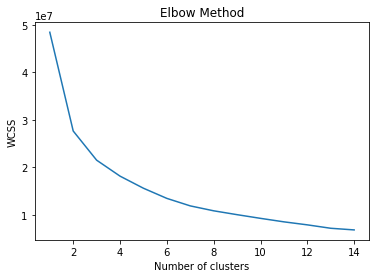

In [13]:
ctt = cluster_triaxial_thresholds
wcss = []
for i in range(1, 15):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(ctt)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 15), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

### X-Axis

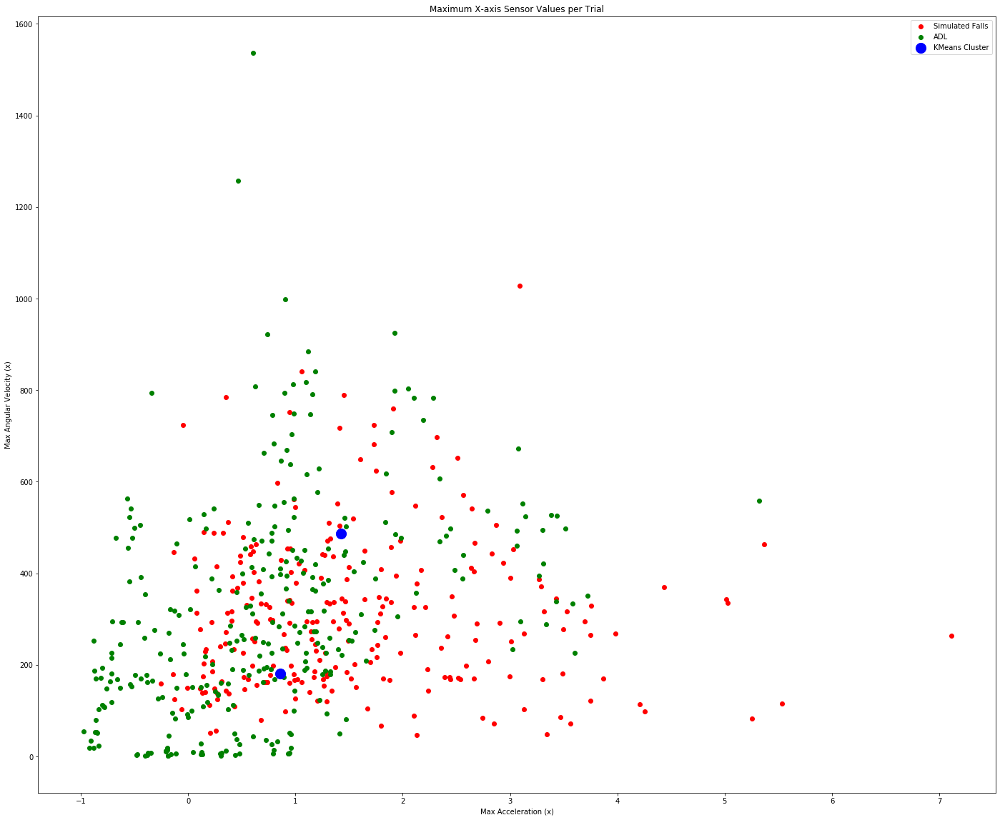

In [14]:
kmeans_MaxX = KMeans(n_clusters=2, init='k-means++', max_iter=300, n_init=10, random_state=0)
pred_MaxX = kmeans_MaxX.fit_predict(ctt)
fig=plt.figure(figsize = (24,20))
plt.scatter(x=ctt.iloc[:,3][ctt['Activity']<6], y=ctt.iloc[:,6][ctt['Activity']<6], c="red", label='Simulated Falls')
plt.scatter(x=ctt.iloc[:,3][ctt['Activity']>5], y=ctt.iloc[:,6][ctt['Activity']>5], c="green", label="ADL")
plt.scatter(kmeans_MaxX.cluster_centers_[:, 3], kmeans_MaxX.cluster_centers_[:, 6], s=200, c='blue', label="KMeans Cluster")
plt.title("Maximum X-axis Sensor Values per Trial")
plt.ylabel("Max Angular Velocity (x)")
plt.xlabel("Max Acceleration (x)")
plt.legend()
plt.show()

In [15]:
kmeans_MaxX.cluster_centers_[:,[3,6]]
# Fall cluster: 1.424 acceleration (x-axis), 487.244 angular velocity (x-axis)
# ADL cluster: 0.859 acceleration (x-axis), 181.375 angular velocity (x-axis)

array([[  1.42352321, 487.24378059],
       [  0.85914596, 181.37465217]])

## Y-Axis

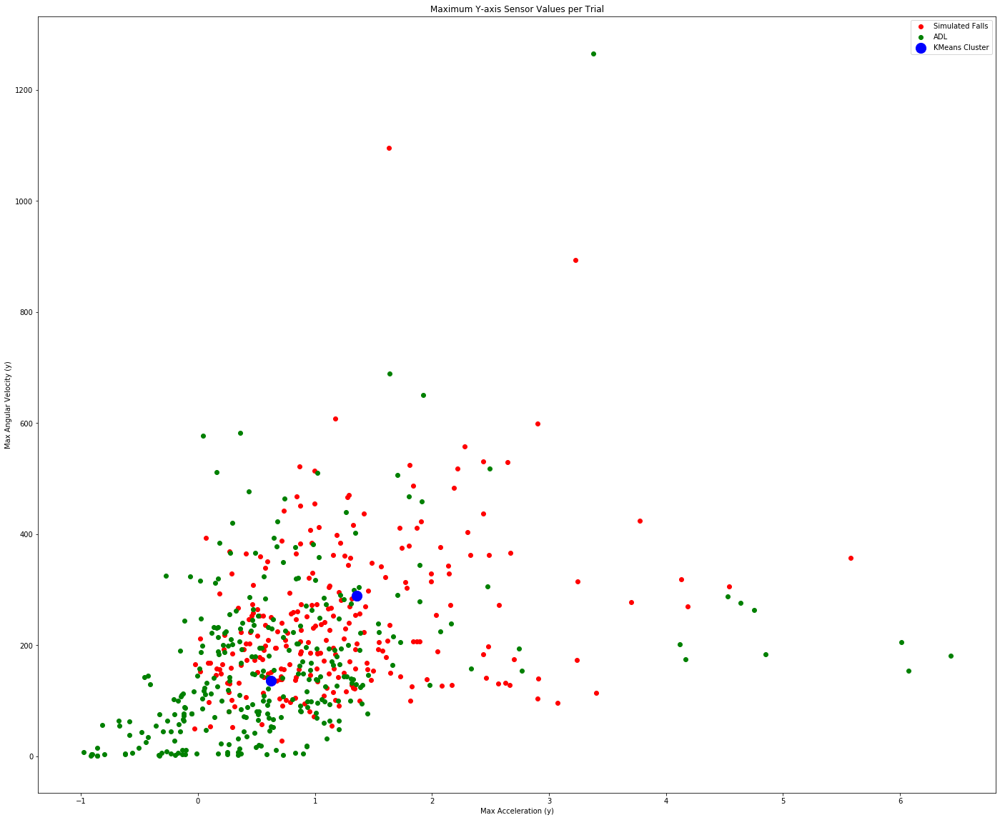

In [16]:
kmeans_MaxY = KMeans(n_clusters=2, init='k-means++', max_iter=300, n_init=10, random_state=0)
pred_MaxY = kmeans_MaxY.fit_predict(ctt)
fig=plt.figure(figsize = (24,20))
plt.scatter(x=ctt.iloc[:,4][ctt['Activity']<6], y=ctt.iloc[:,7][ctt['Activity']<6], c="red", label='Simulated Falls')
plt.scatter(x=ctt.iloc[:,4][ctt['Activity']>5], y=ctt.iloc[:,7][ctt['Activity']>5], c="green", label="ADL")
plt.scatter(kmeans_MaxY.cluster_centers_[:, 4], kmeans_MaxY.cluster_centers_[:, 7], s=200, c='blue', label="KMeans Cluster")
plt.title("Maximum Y-axis Sensor Values per Trial")
plt.ylabel("Max Angular Velocity (y)")
plt.xlabel("Max Acceleration (y)")
plt.legend()
plt.show()

In [17]:
kmeans_MaxY.cluster_centers_[:,[4,7]]
# Fall cluster: 1.359 acceleration (y-axis), 289.069 angular velocity (y-axis)
# ADL cluster: 0.621 acceleration (y-axis), 135.141 angular velocity (y-axis)

array([[  1.35948523, 289.06872152],
       [  0.62132298, 135.14056522]])

## Z-Axis

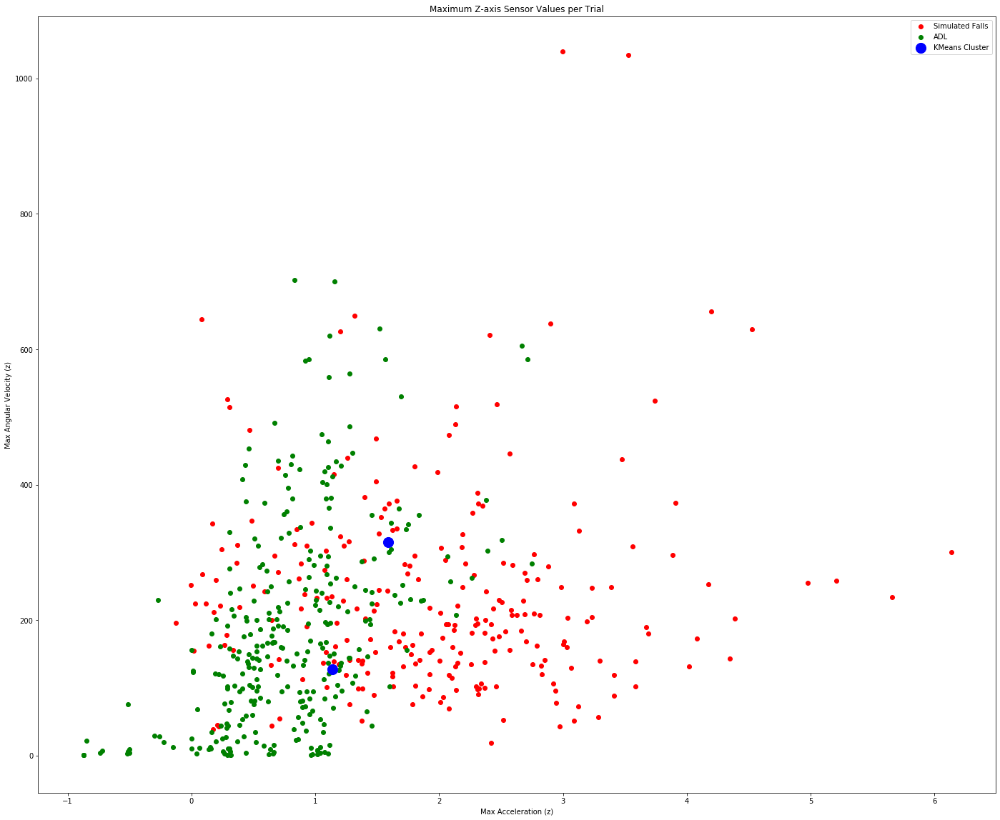

In [18]:
kmeans_MaxZ = KMeans(n_clusters=2, init='k-means++', max_iter=300, n_init=10, random_state=0)
pred_MaxZ = kmeans_MaxZ.fit_predict(ctt)
fig=plt.figure(figsize = (24,20))
plt.scatter(x=ctt.iloc[:,5][ctt['Activity']<6], y=ctt.iloc[:,8][ctt['Activity']<6], c="red", label='Simulated Falls')
plt.scatter(x=ctt.iloc[:,5][ctt['Activity']>5], y=ctt.iloc[:,8][ctt['Activity']>5], c="green", label="ADL")
plt.scatter(kmeans_MaxZ.cluster_centers_[:,5], kmeans_MaxZ.cluster_centers_[:,8], s=200, c='blue', label="KMeans Cluster")
plt.title("Maximum Z-axis Sensor Values per Trial")
plt.ylabel("Max Angular Velocity (z)")
plt.xlabel("Max Acceleration (z)")
plt.legend()
plt.show()

In [19]:
kmeans_MaxZ.cluster_centers_[:,[5,8]]
# Fall cluster: 1.589 acceleration (z-axis), 314.613 angular velocity (z-axis)
# ADL cluster:1.136 acceleration (z-axis), 126.999 angular velocity (z-axis)

array([[  1.58787342, 314.61285654],
       [  1.1356646 , 126.99913354]])

#### Magntiude of Extracted Max Triaxial Clusters

In [20]:
import math
accelerationThreshold_fall=math.sqrt(1.424**2+1.359**2+1.589**2)
angularVelocityThreshold_fall=math.sqrt(487.244**2+289.069**2+314.613**2)
accelerationThreshold_ADL=math.sqrt(0.859**2+0.621**2+1.136**2)
angularVelocityThreshold_ADL=math.sqrt(181.375**2+135.141**2+126.999**2)
print('Acceleration Threshold (Fall): {}'.format(accelerationThreshold_fall))
print('Angular Velocity Threshold (Fall): {}'.format(angularVelocityThreshold_fall))
print('Acceleration Threshold (ADL): {}'.format(accelerationThreshold_ADL))
print('Angular Velocity Threshold (ADL): {}'.format(angularVelocityThreshold_ADL))

Acceleration Threshold (Fall): 2.5297387216864906
Angular Velocity Threshold (Fall): 648.034676592233
Acceleration Threshold (ADL): 1.5537110413458481
Angular Velocity Threshold (ADL): 259.4007064504644


In [21]:
# X-Axis
print('Acceleration Magntiude | Angular Velocity (X-Axis) Threshold (Falls): {} | {}'.format(kmeans_MaxX.cluster_centers_[0,3],kmeans_MaxX.cluster_centers_[0,6]))
print('Acceleration Magntiude | Angular Velocity (X-Axis) Threshold (ADLs): {} | {}'.format(kmeans_MaxX.cluster_centers_[1,3],kmeans_MaxX.cluster_centers_[1,6]))

# Y-Axis
print('Acceleration Magntiude | Angular Velocity (Y-Axis) Threshold (Falls): {} | {}'.format(kmeans_MaxY.cluster_centers_[0,4],kmeans_MaxX.cluster_centers_[0,7]))
print('Acceleration Magntiude | Angular Velocity (Y-Axis) Threshold (ADLs): {} | {}'.format(kmeans_MaxY.cluster_centers_[1,4],kmeans_MaxX.cluster_centers_[1,7]))

# Z-Axis
print('Acceleration Magntiude | Angular Velocity (Z-Axis) Threshold (Falls): {} | {}'.format(kmeans_MaxY.cluster_centers_[0,5],kmeans_MaxX.cluster_centers_[0,8]))
print('Acceleration Magntiude | Angular Velocity (Z-Axis) Threshold (ADLs): {} | {}'.format(kmeans_MaxY.cluster_centers_[1,5],kmeans_MaxX.cluster_centers_[1,8]))


print('Acceleration Magntiude | Angular Velocity Magnitude Threshold (Falls): {} | {}'.format(accelerationThreshold_fall,angularVelocityThreshold_fall))
print('Acceleration Magntiude | Angular Velocity Magnitude Threshold (ADLs): {} | {}'.format(accelerationThreshold_ADL,angularVelocityThreshold_ADL))

Acceleration Magntiude | Angular Velocity (X-Axis) Threshold (Falls): 1.423523206751055 | 487.2437805907173
Acceleration Magntiude | Angular Velocity (X-Axis) Threshold (ADLs): 0.8591459627329192 | 181.37465217391312
Acceleration Magntiude | Angular Velocity (Y-Axis) Threshold (Falls): 1.3594852320675104 | 289.0687215189874
Acceleration Magntiude | Angular Velocity (Y-Axis) Threshold (ADLs): 0.6213229813664598 | 135.14056521739124
Acceleration Magntiude | Angular Velocity (Z-Axis) Threshold (Falls): 1.5878734177215192 | 314.6128565400844
Acceleration Magntiude | Angular Velocity (Z-Axis) Threshold (ADLs): 1.1356645962732919 | 126.99913354037275
Acceleration Magntiude | Angular Velocity Magnitude Threshold (Falls): 2.5297387216864906 | 648.034676592233
Acceleration Magntiude | Angular Velocity Magnitude Threshold (ADLs): 1.5537110413458481 | 259.4007064504644


### SVM classification of Triaxial Clusters

In [22]:
y = cluster_thresholds['Activity'].to_numpy()
y = np.where(y < 6, 1, 0)
distancesX = np.column_stack([np.sum((ctt - center)**2, axis=1)**0.5 for center in kmeans_MaxX.cluster_centers_])
distancesY = np.column_stack([np.sum((ctt - center)**2, axis=1)**0.5 for center in kmeans_MaxY.cluster_centers_])
distancesZ = np.column_stack([np.sum((ctt - center)**2, axis=1)**0.5 for center in kmeans_MaxZ.cluster_centers_])
distances = np.concatenate((distancesX, distancesY, distancesZ), axis=1)
X_train, X_test, y_train, y_test = train_test_split(distances, y, test_size=0.33, random_state=123)

In [23]:
svc = SVC(kernel='rbf', C=10, gamma=100) 
pca = PCA(n_components = 3)
X_train2 = pca.fit_transform(X_train)
svc.fit(X_train2, y_train)

z = lambda x,y: (-svc.intercept_[0]-svc.coef_[0][0]*x-svc.coef_[0][1]*y) / svc.coef_[0][2]

tmp = np.linspace(-2,2,51)
x,y = np.meshgrid(tmp,tmp)

fig = plt.figure()
ax  = fig.add_subplot(111, projection='3d')
ax.plot_surface(x, y, z(x,y))
ax.plot3D(X_train2[y_train==0,0], X_train2[y_train==0,1], X_train2[y_train==0,2],'ob')
ax.plot3D(X_train2[y_train==1,0], X_train2[y_train==1,1], X_train2[y_train==1,2],'sr')
plt.show()

AttributeError: coef_ is only available when using a linear kernel

In [34]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
svc = SVC(kernel='poly', C=5, gamma="auto") 
pca = PCA(n_components = 3)
X_train2 = pca.fit_transform(X_train)
svc.fit(X_train2, y_train)
X_test2 = pca.fit_transform(X_test)
preds = svc.predict(X_test2)

print(accuracy_score(y_test, preds)*100)
print(precision_score(y_test,preds)*100)
print(recall_score(y_test,preds)*100)
print(f1_score(y_test,preds)*100)

## Appendix

### Test on Different Cluster Sizes
3 potential clusters indicated from elbow plot, 11 potential clusters for each experimental activity
* inconclusive results for both

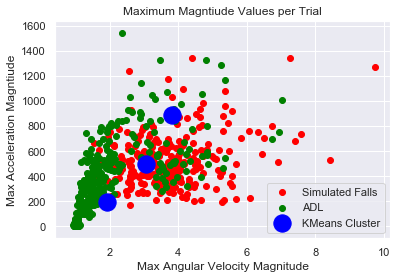

In [315]:
kmeans_c3 = KMeans(n_clusters=3, init='k-means++', max_iter=300, n_init=10, random_state=0)
pred_c3 = kmeans.fit_predict(ct)
plt.scatter(x=ct.iloc[:,3][ct['Activity']<6], y=ct.iloc[:,4][ct['Activity']<6], c="red", label='Simulated Falls')
plt.scatter(x=ct.iloc[:,3][ct['Activity']>5], y=ct.iloc[:,4][ct['Activity']>5], c="green", label="ADL")
plt.scatter(kmeans_c3.cluster_centers_[:, 3], kmeans_c3.cluster_centers_[:, 4], s=300, c='blue', label="KMeans Cluster")
plt.title("Maximum Magntiude Values per Trial (3 clusters)")
plt.xlabel("Max Angular Velocity Magnitude")
plt.ylabel("Max Acceleration Magntiude")
plt.legend()
plt.show()

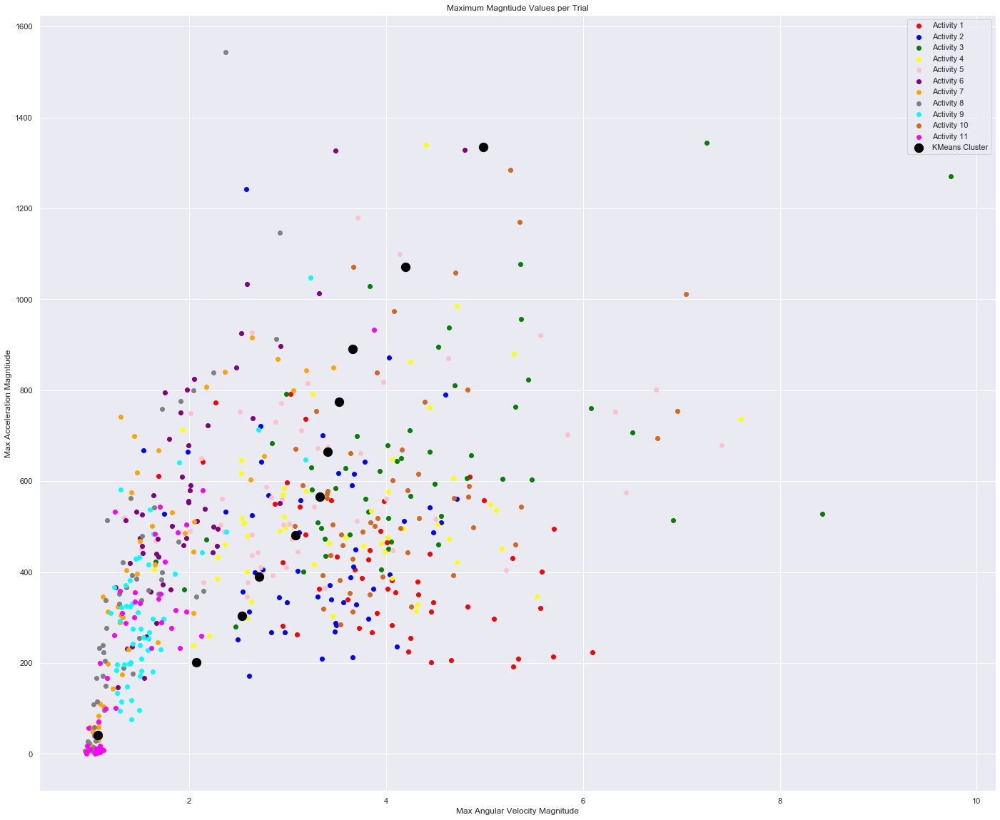

In [319]:
kmeans_c11 = KMeans(n_clusters=11, init='k-means++', max_iter=300, n_init=10, random_state=0)
pred_c11 = kmeans.fit_predict(ct)
fig=plt.figure(figsize = (24,20))
plt.scatter(x=ct.iloc[:,3][ct['Activity']==1], y=ct.iloc[:,4][ct['Activity']==1], c="red", label='Activity 1')
plt.scatter(x=ct.iloc[:,3][ct['Activity']==2], y=ct.iloc[:,4][ct['Activity']==2], c="blue", label='Activity 2')
plt.scatter(x=ct.iloc[:,3][ct['Activity']==3], y=ct.iloc[:,4][ct['Activity']==3], c="green", label='Activity 3')
plt.scatter(x=ct.iloc[:,3][ct['Activity']==4], y=ct.iloc[:,4][ct['Activity']==4], c="yellow", label='Activity 4')
plt.scatter(x=ct.iloc[:,3][ct['Activity']==5], y=ct.iloc[:,4][ct['Activity']==5], c="pink", label='Activity 5')
plt.scatter(x=ct.iloc[:,3][ct['Activity']==6], y=ct.iloc[:,4][ct['Activity']==6], c="purple", label='Activity 6')
plt.scatter(x=ct.iloc[:,3][ct['Activity']==7], y=ct.iloc[:,4][ct['Activity']==7], c="orange", label='Activity 7')
plt.scatter(x=ct.iloc[:,3][ct['Activity']==8], y=ct.iloc[:,4][ct['Activity']==8], c="grey", label='Activity 8')
plt.scatter(x=ct.iloc[:,3][ct['Activity']==9], y=ct.iloc[:,4][ct['Activity']==9], c="cyan", label='Activity 9')
plt.scatter(x=ct.iloc[:,3][ct['Activity']==10], y=ct.iloc[:,4][ct['Activity']==10], c="chocolate", label='Activity 10')
plt.scatter(x=ct.iloc[:,3][ct['Activity']==11], y=ct.iloc[:,4][ct['Activity']==11], c="magenta", label='Activity 11')
plt.scatter(kmeans_ct.cluster_centers_[:, 3], kmeans_ct.cluster_centers_[:, 4], s=150, c='black', label="KMeans Cluster")
plt.title("Maximum Magntiude Values per Trial (11 clusters)")
plt.xlabel("Max Angular Velocity Magnitude")
plt.ylabel("Max Acceleration Magntiude")
plt.legend()
plt.show()

## Additional Testing

In [16]:
raw_WristSensor.iloc[1:,]

,TimeStamp,Accelerometer (x),Accelerometer (y),Accelerometer (z),Angular Velocity (x),Angular Velocity (y),Angular Velocity (z),Subject,Activity,Trial,Acceleration Magntiude,Angular Velocity Magntiude
1,2018-07-04 12:04:17.738369,-1.240,-0.557,0.227,-75.854,44.024,315.915,1.0,1.0,1.0,1.378179,327.863126
2,2018-07-04 12:04:17.790509,-1.240,-0.557,0.227,-28.780,55.549,344.146,1.0,1.0,1.0,1.378179,349.786291
3,2018-07-04 12:04:17.836632,-1.884,-0.687,0.251,27.256,87.134,372.012,1.0,1.0,1.0,2.020996,383.051108
4,2018-07-04 12:04:17.885262,-1.884,-0.687,0.251,2.866,117.683,356.463,1.0,1.0,1.0,2.020996,375.397620
5,2018-07-04 12:04:17.945423,-1.597,-0.646,0.112,10.000,30.671,126.768,1.0,1.0,1.0,1.726346,130.808394
...,...,...,...,...,...,...,...,...,...,...,...,...
294674,2018-07-12 12:18:28.783680,0.310,0.545,0.835,1.220,3.537,-1.220,17.0,11.0,3.0,1.044198,3.935374
294675,2018-07-12 12:18:28.832811,0.304,0.549,0.833,0.976,2.317,-1.159,17.0,11.0,3.0,1.042931,2.768456
294676,2018-07-12 12:18:28.892470,0.318,0.555,0.824,3.598,2.866,-1.402,17.0,11.0,3.0,1.043132,4.808863
294677,2018-07-12 12:18:29.025324,0.321,0.561,0.822,-0.183,2.073,0.000,17.0,11.0,3.0,1.045680,2.081062


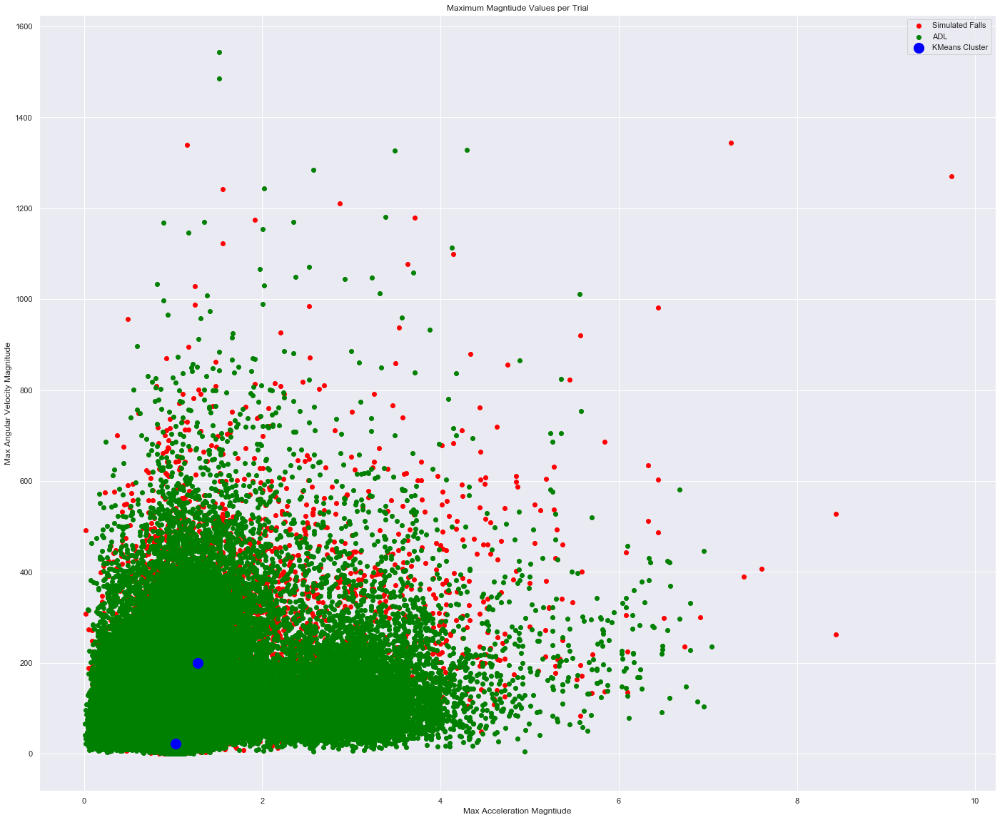

In [348]:
Xt = raw_WristSensor.iloc[1:,]
kmeans_Magntiude = KMeans(n_clusters=2, init='k-means++', max_iter=300, n_init=10, random_state=0)
pred_Magnitude = kmeans_Magnitude.fit_predict(Xt)
fig=plt.figure(figsize = (24,20))
plt.scatter(x=Xt.iloc[:,9][Xt['Activity']<6], y=Xt.iloc[:,10][Xt['Activity']<6], c="red", label='Simulated Falls')
plt.scatter(x=Xt.iloc[:,9][Xt['Activity']>5], y=Xt.iloc[:,10][Xt['Activity']>5], c="green", label="ADL")
plt.scatter(kmeans_Magntiude.cluster_centers_[:,9], kmeans_Magntiude.cluster_centers_[:, 10], s=200, c='blue', label="KMeans Cluster")
plt.title("Magntiude Values per Trial")
plt.ylabel("Angular Velocity")
plt.xlabel("Acceleration")
plt.legend()
plt.show()